In [343]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import plotly.graph_objs as go
import plotly.express as px
import dash
from dash import html
from dash import dcc


***DATAFRAMES***

In [344]:
df_covid = pd.read_csv('Data/covid-data.csv', delimiter=',')
df_eco_covid = pd.read_csv('Data/data_econo_covid.csv', delimiter=';')
df_education = pd.read_csv('Data/Education-GDP.csv', delimiter=',')
df_GDP = pd.read_csv('Data/GDP.csv', delimiter=',')
df_gini = pd.read_csv('Data/gini.csv', delimiter=',')
df_poverty = pd.read_csv('Data/poverty-explorer.csv', delimiter=',')
df_trade = pd.read_csv('Data/trade.csv', delimiter=',')
df_HICP_FR = pd.read_csv('Data/HICP_FR.csv', delimiter=',') #The Harmonized Consumer Price Index (HICP) provides a standardized measure of inflation across EU countries.
df_HICP_BE = pd.read_csv('Data/HICP_BE.csv', delimiter=',')
df_HICP_BU_21 = pd.read_csv('Data/HICP_BU_21.csv', delimiter=',')
df_HICP_FI = pd.read_csv('Data/HICP_FI.csv', delimiter=',')
df_HICP_food_europe = pd.read_csv('Data/HICP_food_europe.csv', delimiter=',')
df_HICP_GR = pd.read_csv('Data/HICP_GR.csv', delimiter=',')
df_HICP_nrj_BU = pd.read_csv('Data/HICP_nrj_BU.csv', delimiter=',')
df_HICP_nrj_GE = pd.read_csv('Data/HICP_nrj_GE.csv', delimiter=',')
df_HICP_nrj_GR = pd.read_csv('Data/HICP_nrj_GR.csv', delimiter=',')
df_HICP_nrj_IT = pd.read_csv('Data/HICP_nrj_IT.csv', delimiter=',')


**Exploration df_covid**

In [345]:
df_covid

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,population,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million
0,AFG,Asia,Afghanistan,2020-01-03,1.0,1.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
1,AFG,Asia,Afghanistan,2020-01-04,1.0,0.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
2,AFG,Asia,Afghanistan,2020-01-05,1.0,0.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
3,AFG,Asia,Afghanistan,2020-01-06,1.0,0.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
4,AFG,Asia,Afghanistan,2020-01-07,1.0,0.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
384463,ZWE,Africa,Zimbabwe,2024-03-01,266350.0,0.0,0.0,5737.0,0.0,0.0,...,30.7,36.791,1.7,61.49,0.571,16320539.0,NaN,NaN,NaN,NaN
384464,ZWE,Africa,Zimbabwe,2024-03-02,266350.0,0.0,0.0,5737.0,0.0,0.0,...,30.7,36.791,1.7,61.49,0.571,16320539.0,NaN,NaN,NaN,NaN
384465,ZWE,Africa,Zimbabwe,2024-03-03,266350.0,0.0,0.0,5737.0,0.0,0.0,...,30.7,36.791,1.7,61.49,0.571,16320539.0,NaN,NaN,NaN,NaN
384466,ZWE,Africa,Zimbabwe,2024-03-04,266350.0,0.0,0.0,5737.0,0.0,0.0,...,30.7,36.791,1.7,61.49,0.571,16320539.0,NaN,NaN,NaN,NaN


Almost all countries have more than 1500 rows in the df_covid table:

In [346]:
df_covid['iso_code'].value_counts().sort_values(ascending=False).head()

iso_code
MEX    1526
ARG    1526
AUT    1524
VGB    1524
BRA    1524
Name: count, dtype: int64

In [347]:
df_covid['iso_code'].value_counts().sort_values(ascending=True).head(10)

iso_code
ESH            1
OWID_CYN     691
MAC          795
OWID_WLS    1198
OWID_SCT    1305
TWN         1348
OWID_ENG    1359
OWID_NIR    1372
HKG         1491
AUS         1524
Name: count, dtype: int64

Removing countries with less than 1524 values:

In [348]:
print("Before removal:")
print(df_covid['iso_code'].value_counts(ascending=True))

countries_to_remove = ['ESH', 'OWID_CYN', 'MAC', 'OWID_WLS', 'OWID_SCT', 'TWN', 'OWID_ENG', 'OWID_NIR', 'HKG']

df_covid = df_covid[~df_covid['iso_code'].isin(countries_to_remove)]

print("\nAfter removal:")
print(df_covid['iso_code'].value_counts(ascending=True))

Before removal:
iso_code
ESH            1
OWID_CYN     691
MAC          795
OWID_WLS    1198
OWID_SCT    1305
            ... 
DEU         1524
GEO         1524
GRL         1524
ARG         1526
MEX         1526
Name: count, Length: 255, dtype: int64

After removal:
iso_code
AFG         1524
NER         1524
NGA         1524
NIU         1524
OWID_NAM    1524
            ... 
GTM         1524
PYF         1524
ZWE         1524
MEX         1526
ARG         1526
Name: count, Length: 246, dtype: int64


In [349]:
df_covid['iso_code'].value_counts().sort_values(ascending=True).head(10)

iso_code
OWID_LIC    1524
BRA         1524
ALB         1524
DZA         1524
ASM         1524
AND         1524
AGO         1524
AIA         1524
ATG         1524
ARM         1524
Name: count, dtype: int64

Pre-selection of rows and columns:

In [350]:
df_covid_europe = df_covid[df_covid['continent'] == 'Europe']
df_covid_europe


,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,population,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million
3048,ALB,Europe,Albania,2020-01-03,NaN,0.0,NaN,NaN,0.0,NaN,...,51.2,NaN,2.89,78.57,0.795,2842318.0,NaN,NaN,NaN,NaN
3049,ALB,Europe,Albania,2020-01-04,NaN,0.0,NaN,NaN,0.0,NaN,...,51.2,NaN,2.89,78.57,0.795,2842318.0,NaN,NaN,NaN,NaN
3050,ALB,Europe,Albania,2020-01-05,NaN,0.0,NaN,NaN,0.0,NaN,...,51.2,NaN,2.89,78.57,0.795,2842318.0,NaN,NaN,NaN,NaN
3051,ALB,Europe,Albania,2020-01-06,NaN,0.0,NaN,NaN,0.0,NaN,...,51.2,NaN,2.89,78.57,0.795,2842318.0,NaN,NaN,NaN,NaN
3052,ALB,Europe,Albania,2020-01-07,NaN,0.0,NaN,NaN,0.0,NaN,...,51.2,NaN,2.89,78.57,0.795,2842318.0,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
372596,VAT,Europe,Vatican,2024-03-01,26.0,0.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,75.12,NaN,808.0,NaN,NaN,NaN,NaN
372597,VAT,Europe,Vatican,2024-03-02,26.0,0.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,75.12,NaN,808.0,NaN,NaN,NaN,NaN
372598,VAT,Europe,Vatican,2024-03-03,26.0,0.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,75.12,NaN,808.0,NaN,NaN,NaN,NaN
372599,VAT,Europe,Vatican,2024-03-04,26.0,0.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,75.12,NaN,808.0,NaN,NaN,NaN,NaN


In [351]:
df_covid_europe = df_covid_europe[['iso_code','location', 'date', 'total_cases', 'total_cases_per_million', 'total_deaths', 'total_deaths_per_million', 'human_development_index', 'population', 'excess_mortality_cumulative_per_million','positive_rate', 'people_vaccinated_per_hundred', 'stringency_index', 'population_density', 'median_age']]
df_covid_europe.head()

,iso_code,location,date,total_cases,total_cases_per_million,total_deaths,total_deaths_per_million,human_development_index,population,excess_mortality_cumulative_per_million,positive_rate,people_vaccinated_per_hundred,stringency_index,population_density,median_age
3048,ALB,Albania,2020-01-03,NaN,NaN,NaN,NaN,0.795,2842318.0,NaN,NaN,NaN,0.0,104.871,38.0
3049,ALB,Albania,2020-01-04,NaN,NaN,NaN,NaN,0.795,2842318.0,NaN,NaN,NaN,0.0,104.871,38.0
3050,ALB,Albania,2020-01-05,NaN,NaN,NaN,NaN,0.795,2842318.0,NaN,NaN,NaN,0.0,104.871,38.0
3051,ALB,Albania,2020-01-06,NaN,NaN,NaN,NaN,0.795,2842318.0,NaN,NaN,NaN,0.0,104.871,38.0
3052,ALB,Albania,2020-01-07,NaN,NaN,NaN,NaN,0.795,2842318.0,NaN,NaN,NaN,0.0,104.871,38.0


Construction of graphs to see if certain groups of countries stand out according to different criteria (Covid related):

In [352]:
#Plot Total Cases

import plotly.express as px

fig = px.line(
    df_covid_europe,
    x='date',
    y='total_cases',
    color='location',
    title='Total COVID-19 Cases Over Time in European Countries',
    labels={'total_cases': 'Total Cases', 'location': 'European Countries'},
)

fig.update_layout(
    xaxis_title='Date',
    yaxis_title='Total Cases',
)

fig.show()


/home/celine/anaconda3/envs/ml/lib/python3.10/site-packages/plotly/express/_core.py:2065: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



excess_mortality_cumulative_per_million could be more interesting than total_deaths because takes into consideration the 'usual' death ratio of the country as well as its population size. We can see with the following graphs that the countries with the highest values are not the same depending on if the criteria "per million" was taken or not. 
excess_mortality_cumulative_per_million and total_deaths look quite similar for most countries, and we have more data for total_deaths so we could choose total_deaths for our analysis?
Let's select "total_deaths", "excess_mortality_cumulative_per_million", "stringency_index", "total_cases_per_million" for now.

In [353]:
# Plot Total Deaths

import plotly.express as px

fig = px.line(
    df_covid_europe,
    x='date',
    y='total_deaths',
    color='location',
    title='Total Deaths Over Time in European Countries',
    labels={'total_deaths': 'Total Deaths', 'location': 'European Countries'},
)

fig.update_layout(
    xaxis_title='Date',
    yaxis_title='Total Deaths',
)

fig.show()

/home/celine/anaconda3/envs/ml/lib/python3.10/site-packages/plotly/express/_core.py:2065: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



In [354]:
# Plot Total Deaths per million

import plotly.express as px

fig = px.line(
    df_covid_europe,
    x='date',
    y='total_deaths_per_million',
    color='location',
    title='Total Deaths (per million) Over Time in European Countries',
    labels={'total_deaths_per_million': 'Total Deaths', 'location': 'European Countries'},
)

fig.update_layout(
    xaxis_title='Date',
    yaxis_title='Total Deaths per million',
)

fig.show()

/home/celine/anaconda3/envs/ml/lib/python3.10/site-packages/plotly/express/_core.py:2065: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



In [355]:

df_covid_europe_copy = df_covid_europe.copy()

In [356]:
# Plot Excess mortality cumulative per million

## Fill NaN values with the weekly average

df_covid_europe_copy['excess_mortality_cumulative_per_million'] = (
    df_covid_europe_copy.groupby('location')['excess_mortality_cumulative_per_million']
    .transform(lambda x: x.fillna(x.rolling(7, min_periods=1).mean()))
)

fig = px.line(
    df_covid_europe_copy,
    x='date',
    y='excess_mortality_cumulative_per_million',
    color='location',
    title='Excess Mortality (cumulative per million) Over Time in European Countries',
    labels={'excess_mortality_cumulative_per_million': 'Excess mortality', 'location': 'European Countries'},
)

fig.update_layout(
    xaxis_title='Date',
    yaxis_title='Excess mortality',
)

fig.show()


/home/celine/anaconda3/envs/ml/lib/python3.10/site-packages/plotly/express/_core.py:2065: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



In [357]:
#Sort countries based on their excess_mortality_cumulative_per_million and total_deaths_per_million values on the 01.01.2024:

df_snapshot_2024 = df_covid_europe_copy[df_covid_europe_copy['date'] == '2024-01-01'].copy()

df_snapshot_2024.loc[:, 'rank_excess_mortality'] = df_snapshot_2024['excess_mortality_cumulative_per_million'].rank(ascending=False)

df_snapshot_2024.loc[:, 'rank_total_deaths'] = df_snapshot_2024['total_deaths_per_million'].rank(ascending=False)

df_snapshot_2024.loc[:, 'rank_stringency_index'] = df_snapshot_2024['stringency_index'].rank(ascending=False)  # just curiosity

result_table = df_snapshot_2024[['location', 'rank_excess_mortality', 'rank_total_deaths', 'stringency_index']].sort_values(by='rank_excess_mortality')

result_table



,location,rank_excess_mortality,rank_total_deaths,stringency_index
193287,Lithuania,1.0,14.0,NaN
51753,Bulgaria,2.0,1.0,NaN
250472,North Macedonia,3.0,4.0,NaN
79185,Croatia,4.0,6.0,NaN
184143,Latvia,5.0,9.0,NaN
313276,Slovakia,6.0,10.0,NaN
281491,Romania,7.0,15.0,NaN
165855,Italy,8.0,18.0,NaN
85281,Czechia,9.0,8.0,NaN
152139,Hungary,10.0,3.0,NaN


In [358]:
#Sort countries based on their excess_mortality_cumulative_per_million and total_deaths_per_million values on the 01.01.2022:

df_snapshot_2024b = df_covid_europe_copy[df_covid_europe_copy['date'] == '2022-01-01'].copy()

df_snapshot_2024b.loc[:, 'rank_excess_mortality'] = df_snapshot_2024b['excess_mortality_cumulative_per_million'].rank(ascending=False)

df_snapshot_2024b.loc[:, 'rank_total_deaths'] = df_snapshot_2024b['total_deaths_per_million'].rank(ascending=False)

df_snapshot_2024b.loc[:, 'rank_stringency_index'] = df_snapshot_2024b['stringency_index'].rank(ascending=False)  # just curiosity

result_table = df_snapshot_2024b[['location', 'rank_excess_mortality', 'rank_total_deaths', 'rank_stringency_index']].sort_values(by='rank_excess_mortality')

result_table



,location,rank_excess_mortality,rank_total_deaths,rank_stringency_index
51023,Bulgaria,1.0,1.0,17.0
282285,Russia,2.0,21.0,10.0
304926,Serbia,3.0,27.0,42.0
249742,North Macedonia,4.0,3.0,NaN
192557,Lithuania,5.0,14.0,43.0
43403,Bosnia and Herzegovina,6.0,2.0,36.0
280761,Romania,7.0,10.0,4.5
3777,Albania,8.0,37.0,16.0
219262,Moldova,9.0,7.0,23.0
223834,Montenegro,10.0,5.0,NaN


In [359]:
# Plot Stringency Index

fig = px.line(
    df_covid_europe,
    x='date',
    y='stringency_index',
    color='location',
    title='stringency index Over Time in European Countries',
    labels={'stringency_index': 'Stringency Index', 'location': 'European Countries'},
)

fig.update_layout(
    xaxis_title='Date',
    yaxis_title='Stringency Index',
)

fig.show()


/home/celine/anaconda3/envs/ml/lib/python3.10/site-packages/plotly/express/_core.py:2065: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



In [360]:
# Select the countries of interest
selected_countries = ['France', 'Germany', 'Italy', 'Greece', 'Norway']

# Filter the DataFrame for the selected countries
df_covid_europe_5countries = df_covid_europe_copy[df_covid_europe_copy['location'].isin(selected_countries)]

In [361]:
#curiosity: stringency index vs total cases

fig = px.line(
    df_covid_europe_5countries,
    x='date',
    y=['stringency_index', 'total_cases'],
    color='location',
    labels={'value': 'Value', 'variable': 'Metric', 'date': 'Date'},
    title='Stringency Index and Total Cases Over Time for Selected Countries',
)

fig.update_layout(
    xaxis_title='Date',
    yaxis_title='Value',
)

fig.show()


In [362]:
import plotly.graph_objects as go


# Create a line plot for each country
fig = go.Figure()

for country in selected_countries:
    country_data = df_covid_europe_5countries[df_covid_europe_5countries['location'] == country]
    fig.add_trace(go.Scatter(
        x=country_data['date'],
        y=country_data['total_cases'],
        mode='lines+markers',
        name=f'Total Cases - {country}',
    ))
    fig.add_trace(go.Scatter(
        x=country_data['date'],
        y=country_data['stringency_index'],
        mode='lines+markers',
        name=f'Stringency Index - {country}',
        yaxis='y2',
    ))

# Update layout
fig.update_layout(
    xaxis_title='Date',
    yaxis_title='Total Cases',
    yaxis2=dict(title='Stringency Index', overlaying='y', side='right'),
    title='Total Cases and Stringency Index Over Time for Selected Countries',
    showlegend=True,
)

fig.show()


In [363]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from sklearn.preprocessing import MinMaxScaler

# Normalize total cases
scaler_total_cases = MinMaxScaler()
df_covid_europe_5countries['normalized_total_cases'] = scaler_total_cases.fit_transform(df_covid_europe_5countries['total_cases'].values.reshape(-1, 1))

# Normalize stringency index
scaler_stringency_index = MinMaxScaler()
df_covid_europe_5countries['normalized_stringency_index'] = scaler_stringency_index.fit_transform(df_covid_europe_5countries['stringency_index'].values.reshape(-1, 1))

# Create subplots
fig = make_subplots(rows=len(selected_countries), cols=1, shared_xaxes=True, subplot_titles=selected_countries)

# Add traces for each country
for i, country in enumerate(selected_countries, 1):
    country_data = df_covid_europe_5countries[df_covid_europe_5countries['location'] == country]
    
    # Add normalized total cases trace
    fig.add_trace(go.Scatter(
        x=country_data['date'],
        y=country_data['normalized_total_cases'],
        mode='lines+markers',
        name=f'Normalized Total Cases - {country}',
    ), row=i, col=1)
    
    # Add normalized stringency index trace
    fig.add_trace(go.Scatter(
        x=country_data['date'],
        y=country_data['normalized_stringency_index'],
        mode='lines+markers',
        name=f'Normalized Stringency Index - {country}',
        yaxis='y2',
    ), row=i, col=1)

    # Update layout to add secondary y-axis
    fig.update_layout(
        yaxis2=dict(
            title='Normalized Stringency Index',
            overlaying='y',
            side='right',
        ),
    )

# Update layout
fig.update_layout(
    height=2000,
    showlegend=True,
    title_text='Normalized Total Cases and Stringency Index Over Time for Selected Countries',
)

fig.update_xaxes(title_text='Date', row=len(selected_countries), col=1)
fig.update_yaxes(title_text='Normalized Total Cases', row=(len(selected_countries) + 1) // 2, col=1)

fig.show()


/tmp/ipykernel_3825/1648306763.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_3825/1648306763.py:11: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Construction of graphs to see if certain groups of countries stand out according to different criteria (demographic-economic):

In [364]:
# Check the countries for which we don't have any values for the features 'population', 'population_density', 'median_age', 'human_development_index'

df_missing_data = df_covid_europe.groupby('location').agg({
    'population': 'mean',
    'population_density': 'mean',
    'median_age': 'mean',
    'human_development_index': 'mean'
}).reset_index()

df_missing_data = df_missing_data[df_missing_data[['population', 'population_density', 'median_age', 'human_development_index']].isnull().any(axis=1)]

missing_data_location = df_missing_data['location'].tolist()
missing_data_location

['Andorra',
 'Faeroe Islands',
 'Gibraltar',
 'Guernsey',
 'Isle of Man',
 'Jersey',
 'Kosovo',
 'Liechtenstein',
 'Monaco',
 'San Marino',
 'Vatican']

In [365]:
df_covid_europe_filtered = df_covid_europe[~df_covid_europe['location'].isin(missing_data_location)]
df_covid_europe_filtered

,iso_code,location,date,total_cases,total_cases_per_million,total_deaths,total_deaths_per_million,human_development_index,population,excess_mortality_cumulative_per_million,positive_rate,people_vaccinated_per_hundred,stringency_index,population_density,median_age
3048,ALB,Albania,2020-01-03,NaN,NaN,NaN,NaN,0.795,2842318.0,NaN,NaN,NaN,0.0,104.871,38.0
3049,ALB,Albania,2020-01-04,NaN,NaN,NaN,NaN,0.795,2842318.0,NaN,NaN,NaN,0.0,104.871,38.0
3050,ALB,Albania,2020-01-05,NaN,NaN,NaN,NaN,0.795,2842318.0,NaN,NaN,NaN,0.0,104.871,38.0
3051,ALB,Albania,2020-01-06,NaN,NaN,NaN,NaN,0.795,2842318.0,NaN,NaN,NaN,0.0,104.871,38.0
3052,ALB,Albania,2020-01-07,NaN,NaN,NaN,NaN,0.795,2842318.0,NaN,NaN,NaN,0.0,104.871,38.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
361928,GBR,United Kingdom,2024-03-01,24905351.0,368919.324,232112.0,3438.241,0.932,67508936.0,NaN,NaN,NaN,NaN,272.898,40.8
361929,GBR,United Kingdom,2024-03-02,24905351.0,368919.324,232112.0,3438.241,0.932,67508936.0,NaN,NaN,NaN,NaN,272.898,40.8
361930,GBR,United Kingdom,2024-03-03,24905351.0,368919.324,232112.0,3438.241,0.932,67508936.0,NaN,NaN,NaN,NaN,272.898,40.8
361931,GBR,United Kingdom,2024-03-04,24905351.0,368919.324,232112.0,3438.241,0.932,67508936.0,NaN,NaN,NaN,NaN,272.898,40.8


In [366]:
#Plot Human development index

df_covid_europe_grouped = df_covid_europe_filtered.groupby('location')['human_development_index'].mean().reset_index()
df_covid_europe_grouped = df_covid_europe_grouped.sort_values(by='human_development_index')

color_scale = [
    (0, 'yellow'),        # Very low population density
    (0.25, 'orange'),     # Low-median
    (0.5, 'red'),         # Median-high
    (0.75, 'purple'),     # Very high population density
    (1, 'purple')         # Very high population density
]


fig = px.bar(
    df_covid_europe_grouped,
    x='location',
    y='human_development_index',
    title='Human Development Index of European Countries (Excluding Monaco, Gibraltar, Malta)',
    labels={'human_development_index': 'Human development index', 'location': 'European Countries'},
    color='human_development_index',
    color_continuous_scale=color_scale
)

fig.update_layout(
    xaxis_title='European Countries',
    yaxis_title='Human development index',
)

fig.show()


In [367]:
# Plot population

df_covid_europe_grouped = df_covid_europe_filtered.groupby('location')['population'].mean().reset_index()
df_covid_europe_grouped = df_covid_europe_grouped.sort_values(by='population')

color_scale = [
    (0, 'yellow'),        # Very low population density
    (0.25, 'orange'),     # Low-median
    (0.5, 'red'),         # Median-high
    (0.75, 'purple'),     # Very high population density
    (1, 'purple')         # Very high population density
]


fig = px.bar(
    df_covid_europe_grouped,
    x='location',
    y='population',
    title='population of European Countries (Excluding Monaco, Gibraltar, Malta)',
    labels={'population': 'population', 'location': 'European Countries'},
    color='population',
    color_continuous_scale=color_scale
)

fig.update_layout(
    xaxis_title='European Countries',
    yaxis_title='population',
)

fig.show()


In [368]:
# Plot population_density

df_covid_europe_grouped = df_covid_europe_filtered.groupby('location')['population_density'].mean().reset_index()
df_covid_europe_grouped = df_covid_europe_grouped.sort_values(by='population_density')

color_scale = [
    (0, 'yellow'),        # Very low population density
    (0.25, 'orange'),     # Low-median
    (0.5, 'red'),         # Median-high
    (0.75, 'purple'),     # Very high population density
    (1, 'purple')         # Very high population density
]


fig = px.bar(
    df_covid_europe_grouped,
    x='location',
    y='population_density',
    title='Population density of European Countries (Excluding Monaco, Gibraltar, Malta)',
    labels={'population_density': 'Population density', 'location': 'European Countries'},
    color='population_density',
    color_continuous_scale=color_scale
)

fig.update_layout(
    xaxis_title='European Countries',
    yaxis_title='Population density',
)

fig.show()

In [369]:
# Plot median_age

df_covid_europe_grouped = df_covid_europe_filtered.groupby('location')['median_age'].mean().reset_index()
df_covid_europe_grouped = df_covid_europe_grouped.sort_values(by='median_age')

color_scale = [
    (0, 'yellow'),        # Very low population density
    (0.25, 'orange'),     # Low-median
    (0.5, 'red'),         # Median-high
    (0.75, 'purple'),     # Very high population density
    (1, 'purple')         # Very high population density
]


fig = px.bar(
    df_covid_europe_grouped,
    x='location',
    y='median_age',
    title='Median Age of European Countries (Excluding Monaco, Gibraltar, Malta)',
    labels={'populatmedian_ageion_density': 'Median Age', 'location': 'European Countries'},
    color='median_age',
    color_continuous_scale=color_scale
)

fig.update_layout(
    xaxis_title='European Countries',
    yaxis_title='Median age',
)

fig.show()

In [370]:
import plotly.express as px

fig = px.violin(
    df_covid_europe_grouped,
    y='median_age',
    box=True,  # Include box plot inside the violin
    points="all",  # Display individual data points
    title='Distribution of Median Age in European Countries',
    labels={'median_age': 'Median Age', 'location': 'European Countries'},
)

fig.update_layout(
    xaxis_title='European Countries',
    yaxis_title='Median Age',
)

fig.show()


In [371]:
# Relation human_development_index and population_density

fig = px.scatter(
    df_covid_europe_filtered,
    x='human_development_index',
    y='population_density',
    title='Relation Between Population density and Human Development Index',
    labels={'human_development_index': 'Human Development Index', 'population_density': 'population_density'},
    hover_data=['location'],  # Display country names on hover
)

fig.update_layout(
    xaxis_title='Human Development Index',
    yaxis_title='Population Density',
)

fig.show()



Having only one value per country, we can still identify groups of countries which are often close to each other according to those criterias:
norway belgium/finland greece/italy bulgaria france/germany
Those countries represent well the diversity of the europe continent, also according to covid related graphs.
We should choose the ones which have the most data for the features we want to analyse.

Cannot show the relation between covid and economy according to this table only because only one value per country for the economy criterias ?

In [372]:
df_covid_europe_5countries.head()

,iso_code,location,date,total_cases,total_cases_per_million,total_deaths,total_deaths_per_million,human_development_index,population,excess_mortality_cumulative_per_million,positive_rate,people_vaccinated_per_hundred,stringency_index,population_density,median_age,normalized_total_cases,normalized_stringency_index
115661,FRA,France,2020-01-03,16.0,0.248,NaN,NaN,0.901,67813000.0,NaN,NaN,NaN,0.0,122.578,42.0,3.846401e-07,0.0
115662,FRA,France,2020-01-04,16.0,0.248,NaN,NaN,0.901,67813000.0,NaN,NaN,NaN,0.0,122.578,42.0,3.846401e-07,0.0
115663,FRA,France,2020-01-05,16.0,0.248,NaN,NaN,0.901,67813000.0,-15.542791,NaN,NaN,0.0,122.578,42.0,3.846401e-07,0.0
115664,FRA,France,2020-01-06,16.0,0.248,NaN,NaN,0.901,67813000.0,-15.542791,NaN,NaN,0.0,122.578,42.0,3.846401e-07,0.0
115665,FRA,France,2020-01-07,16.0,0.248,NaN,NaN,0.901,67813000.0,-15.542791,NaN,NaN,0.0,122.578,42.0,3.846401e-07,0.0


In [373]:
'''
df_covid_europe_5countries_grouped = df_covid_europe_5countries.groupby('location')['human_development_index'].mean().reset_index()
df_covid_europe_5countries_grouped = df_covid_europe_5countries.sort_values(by='human_development_index')

df_covid_europe_5countries_grouped = df_covid_europe_5countries.groupby('location')['population_density'].mean().reset_index()
df_covid_europe_5countries_grouped = df_covid_europe_5countries.sort_values(by='population_density')

df_covid_europe_5countries_grouped = df_covid_europe_5countries.groupby('location')['population'].mean().reset_index()
df_covid_europe_5countries_grouped = df_covid_europe_5countries.sort_values(by='population')

df_covid_europe_5countries_grouped = df_covid_europe_5countries.groupby('location')['median_age'].mean().reset_index()
df_covid_europe_5countries_grouped = df_covid_europe_5countries.sort_values(by='median_age')
'''

"\ndf_covid_europe_5countries_grouped = df_covid_europe_5countries.groupby('location')['human_development_index'].mean().reset_index()\ndf_covid_europe_5countries_grouped = df_covid_europe_5countries.sort_values(by='human_development_index')\n\ndf_covid_europe_5countries_grouped = df_covid_europe_5countries.groupby('location')['population_density'].mean().reset_index()\ndf_covid_europe_5countries_grouped = df_covid_europe_5countries.sort_values(by='population_density')\n\ndf_covid_europe_5countries_grouped = df_covid_europe_5countries.groupby('location')['population'].mean().reset_index()\ndf_covid_europe_5countries_grouped = df_covid_europe_5countries.sort_values(by='population')\n\ndf_covid_europe_5countries_grouped = df_covid_europe_5countries.groupby('location')['median_age'].mean().reset_index()\ndf_covid_europe_5countries_grouped = df_covid_europe_5countries.sort_values(by='median_age')\n"

In [374]:
import plotly.express as px

# Select the columns of interest
columns_of_interest = ['location', 'date', 'total_deaths', 'human_development_index']

# Filter the DataFrame for the selected columns and countries
df_covid_economy_relation = df_covid_europe_5countries[columns_of_interest]

# Find the maximum value of total_deaths_per_million for scaling
max_deaths_per_million = df_covid_economy_relation['total_deaths'].max()

# Scale human development index values to the range of total_deaths_per_million
df_covid_economy_relation['scaled_hd_index'] = (
    df_covid_economy_relation['human_development_index'] / df_covid_economy_relation['human_development_index'].max()
) * max_deaths_per_million

# Create a line chart
fig = px.line(
    df_covid_economy_relation,
    x='date',
    y='total_deaths',
    color='location',
    title='Relation Between Total Deaths and Scaled Human Development Index Over Time',
    labels={'total_deaths': 'Total Deaths', 'date': 'Date'},
    line_shape='linear',  # Connect data points with lines
    hover_data=['location'],  # Display country names on hover
)

# Add scaled line for human development index
for country in df_covid_economy_relation['location'].unique():
    hd_index_scaled = df_covid_economy_relation[df_covid_economy_relation['location'] == country]['scaled_hd_index'].iloc[0]
    fig.add_shape(
        dict(
            type='line',
            x0=df_covid_economy_relation['date'].min(),
            x1=df_covid_economy_relation['date'].max(),
            y0=hd_index_scaled,
            y1=hd_index_scaled,
            line=dict(color='gray', width=2, dash='dash'),
            name=f'{country} Scaled Human Development Index',
        )
    )

fig.update_layout(
    xaxis_title='Date',
    yaxis_title='Total Deaths',
)

fig.show()


/tmp/ipykernel_3825/2897196238.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/celine/anaconda3/envs/ml/lib/python3.10/site-packages/plotly/express/_core.py:2065: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



In [375]:
import plotly.express as px

# Select the columns of interest
columns_of_interest = ['location', 'date', 'total_deaths_per_million', 'human_development_index']

# Filter the DataFrame for the selected columns and countries
df_covid_economy_relation = df_covid_europe_5countries[columns_of_interest]

# Create line plots for COVID-19 features
fig = px.line(
    df_covid_economy_relation,
    x='date',
    y='total_deaths_per_million',
    color='location',
    title='Total Deaths per Million Over Time',
    labels={'total_deaths_per_million': 'Total Deaths per Million', 'date': 'Date'},
)

# Add horizontal lines for human development index
for country in df_covid_economy_relation['location'].unique():
    hd_index_value = df_covid_economy_relation[df_covid_economy_relation['location'] == country]['human_development_index'].iloc[0]
    fig.add_shape(
        dict(
            type='line',
            x0=df_covid_economy_relation['date'].min(),
            x1=df_covid_economy_relation['date'].max(),
            y0=hd_index_value,
            y1=hd_index_value,
            line=dict(color='gray', width=2, dash='dash'),
            name=f'{country} Human Development Index',
        )
    )

fig.update_layout(
    xaxis_title='Date',
    yaxis_title='Total Deaths per Million',
)

fig.show()


/home/celine/anaconda3/envs/ml/lib/python3.10/site-packages/plotly/express/_core.py:2065: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



In [376]:
import plotly.express as px

# Select the columns of interest
columns_of_interest = ['location', 'date', 'total_deaths_per_million', 'human_development_index']

# Filter the DataFrame for the selected columns and countries
df_covid_economy_relation = df_covid_europe_5countries[columns_of_interest]

# Create a scatter plot
fig = px.scatter(
    df_covid_economy_relation,
    x='total_deaths_per_million',
    y='human_development_index',
    color='date',
    size_max=20,
    hover_data=['location'],
    title='Relation Between Total Deaths per Million and Human Development Index Across Countries',
    labels={'total_deaths_per_million': 'Total Deaths per Million', 'human_development_index': 'Human Development Index'},
)

fig.show()


/home/celine/anaconda3/envs/ml/lib/python3.10/site-packages/plotly/express/_core.py:2065: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



* Rest for the covid table on analysis-short

We have kept 
the features ['iso_code','location', 'date', 'total_deaths', 'stringency_index', 'total_cases_per_million', 'human_development_index']
the countries ['Norway', 'Belgium', 'Finland', 'Greece', 'Italy', 'Bulgaria', 'France', 'Germany'] (think of removing Bulgaria, Greece and Norway)

In [377]:
df_covid_europe = df_covid_europe[['iso_code','location', 'date', 'total_deaths', 'stringency_index', 'total_cases_per_million', 'human_development_index']]
df_covid_europe.head()

,iso_code,location,date,total_deaths,stringency_index,total_cases_per_million,human_development_index
3048,ALB,Albania,2020-01-03,NaN,0.0,NaN,0.795
3049,ALB,Albania,2020-01-04,NaN,0.0,NaN,0.795
3050,ALB,Albania,2020-01-05,NaN,0.0,NaN,0.795
3051,ALB,Albania,2020-01-06,NaN,0.0,NaN,0.795
3052,ALB,Albania,2020-01-07,NaN,0.0,NaN,0.795


In [378]:
# Select the countries of interest
selected_countries = ['Norway', 'Belgium', 'Finland', 'Greece', 'Italy', 'Bulgaria', 'France', 'Germany']

# Filter the DataFrame for the selected countries
df_covid_europe_8countries = df_covid_europe[df_covid_europe['location'].isin(selected_countries)]

df_covid_europe_8countries

,iso_code,location,date,total_deaths,stringency_index,total_cases_per_million,human_development_index
32006,BEL,Belgium,2020-01-03,NaN,0.0,0.086,0.931
32007,BEL,Belgium,2020-01-04,NaN,0.0,0.086,0.931
32008,BEL,Belgium,2020-01-05,NaN,0.0,0.086,0.931
32009,BEL,Belgium,2020-01-06,NaN,0.0,0.086,0.931
32010,BEL,Belgium,2020-01-07,NaN,0.0,0.086,0.931
...,...,...,...,...,...,...,...
255643,NOR,Norway,2024-03-01,5732.0,NaN,277245.339,0.957
255644,NOR,Norway,2024-03-02,5732.0,NaN,277245.339,0.957
255645,NOR,Norway,2024-03-03,5732.0,NaN,277245.339,0.957
255646,NOR,Norway,2024-03-04,5732.0,NaN,277245.339,0.957


In [379]:
# Select the features of interest
columns_of_interest = ['iso_code','location', 'date', 'total_deaths', 'stringency_index', 'total_cases_per_million', 'human_development_index']

# Filter the DataFrame for the selected columns and countries
df_covid_europe_8countries_4features = df_covid_europe_8countries[columns_of_interest]

df_covid_europe_8countries_4features

,iso_code,location,date,total_deaths,stringency_index,total_cases_per_million,human_development_index
32006,BEL,Belgium,2020-01-03,NaN,0.0,0.086,0.931
32007,BEL,Belgium,2020-01-04,NaN,0.0,0.086,0.931
32008,BEL,Belgium,2020-01-05,NaN,0.0,0.086,0.931
32009,BEL,Belgium,2020-01-06,NaN,0.0,0.086,0.931
32010,BEL,Belgium,2020-01-07,NaN,0.0,0.086,0.931
...,...,...,...,...,...,...,...
255643,NOR,Norway,2024-03-01,5732.0,NaN,277245.339,0.957
255644,NOR,Norway,2024-03-02,5732.0,NaN,277245.339,0.957
255645,NOR,Norway,2024-03-03,5732.0,NaN,277245.339,0.957
255646,NOR,Norway,2024-03-04,5732.0,NaN,277245.339,0.957


In [380]:
# Replace NaN values in 'stringency_index' with 0
df_covid_europe_8countries_4features['stringency_index'] = df_covid_europe_8countries_4features['stringency_index'].fillna(0)

df_covid_europe_8countries_4features

,iso_code,location,date,total_deaths,stringency_index,total_cases_per_million,human_development_index
32006,BEL,Belgium,2020-01-03,NaN,0.0,0.086,0.931
32007,BEL,Belgium,2020-01-04,NaN,0.0,0.086,0.931
32008,BEL,Belgium,2020-01-05,NaN,0.0,0.086,0.931
32009,BEL,Belgium,2020-01-06,NaN,0.0,0.086,0.931
32010,BEL,Belgium,2020-01-07,NaN,0.0,0.086,0.931
...,...,...,...,...,...,...,...
255643,NOR,Norway,2024-03-01,5732.0,0.0,277245.339,0.957
255644,NOR,Norway,2024-03-02,5732.0,0.0,277245.339,0.957
255645,NOR,Norway,2024-03-03,5732.0,0.0,277245.339,0.957
255646,NOR,Norway,2024-03-04,5732.0,0.0,277245.339,0.957


**Exploration df_HICP_FR**

In [381]:
df_HICP_FR

,Month,HICP_France_2018-2023
0,Jan 18,102.06
1,Feb 18,102.05
2,Mar 18,103.22
3,Apr 18,103.43
4,May 18,103.92
...,...,...
65,Jun 23,120.71
66,Jul 23,120.77
67,Aug 23,122.10
68,Sep 23,121.40


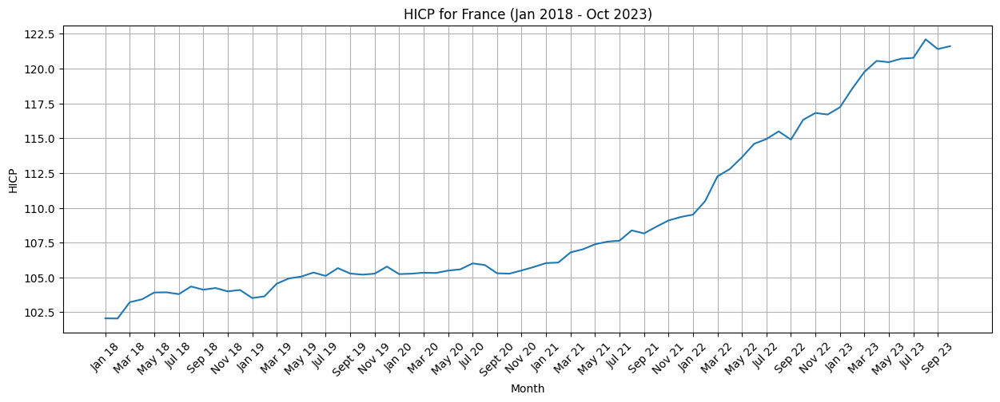

In [382]:
import pandas as pd
import matplotlib.pyplot as plt


# Plot the time series
plt.figure(figsize=(15, 5))
plt.plot(df_HICP_FR['Month'], df_HICP_FR['HICP_France_2018-2023'])
plt.title('HICP for France (Jan 2018 - Oct 2023)')
plt.xlabel('Month')
plt.ylabel('HICP')
plt.xticks(rotation=45)
plt.xticks(df_HICP_FR['Month'][::2])
plt.grid(True)
plt.show()


In [383]:
summary_stats = df_HICP_FR['HICP_France_2018-2023'].describe()
print(summary_stats)


count     70.000000
mean     109.031714
std        5.906146
min      102.050000
25%      105.132500
50%      105.950000
75%      113.417500
max      122.100000
Name: HICP_France_2018-2023, dtype: float64


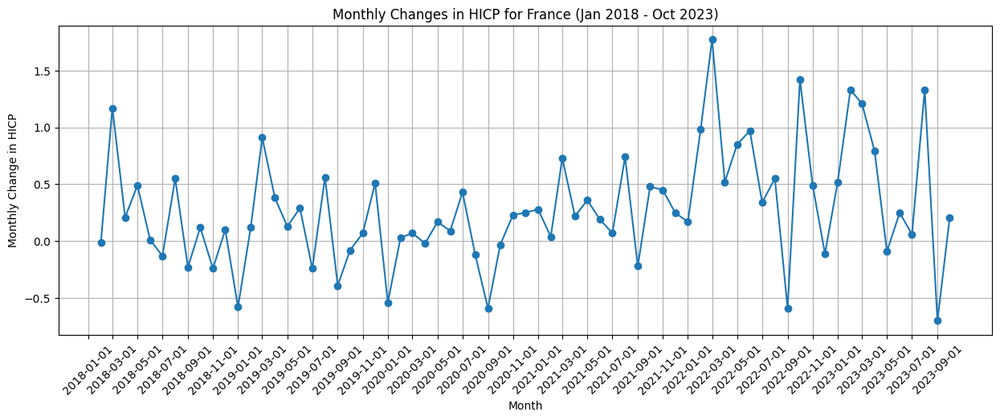

In [384]:
# Calculate and plot the monthly changes
# Replace "Sept" with "Sep" in the "Month" column
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose

df_HICP_FR['Month'] = df_HICP_FR['Month'].str.replace('Sept', 'Sep')

df_HICP_FR['Month'] = pd.to_datetime(df_HICP_FR['Month'], format='%b %y')
df_HICP_FR['Monthly_Change'] = df_HICP_FR['HICP_France_2018-2023'].diff()

plt.figure(figsize=(15, 5))
plt.plot(df_HICP_FR['Month'], df_HICP_FR['Monthly_Change'], marker='o')
plt.title('Monthly Changes in HICP for France (Jan 2018 - Oct 2023)')
plt.xlabel('Month')
plt.ylabel('Monthly Change in HICP')
plt.xticks(rotation=45)
plt.xticks(df_HICP_FR['Month'][::2])
plt.grid(True)
plt.show()



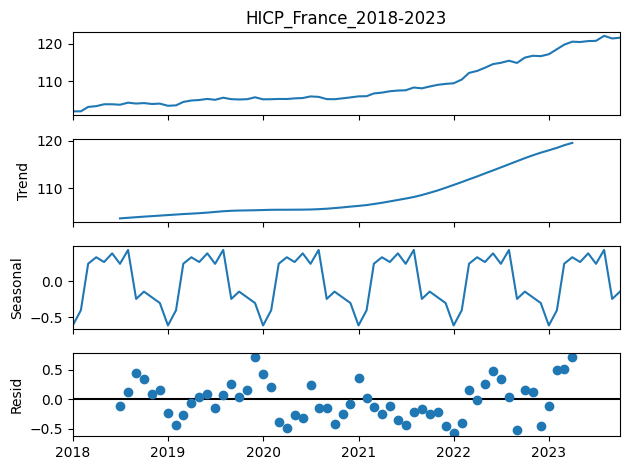

<Figure size 1500x500 with 0 Axes>

In [385]:
# Seasonal decomposition
result = seasonal_decompose(df_HICP_FR.set_index('Month')['HICP_France_2018-2023'], model='additive', period=12)

# Plot the decomposition
result.plot()
plt.figure(figsize=(15, 5))
plt.show()

Exploration and merge of all inflation dataframes:

In [386]:

# Read the dataframes
df_HICP_FR = pd.read_csv('Data/HICP_FR.csv', delimiter=',')
df_HICP_BE = pd.read_csv('Data/HICP_BE.csv', delimiter=',')
df_HICP_BU_21 = pd.read_csv('Data/HICP_BU_21.csv', delimiter=',')
df_HICP_FI = pd.read_csv('Data/HICP_FI.csv', delimiter=',')
df_HICP_food_europe = pd.read_csv('Data/HICP_food_europe.csv', delimiter=',')
df_HICP_GR = pd.read_csv('Data/HICP_GR.csv', delimiter=',')
df_HICP_nrj_BU = pd.read_csv('Data/HICP_nrj_BU.csv', delimiter=',')
df_HICP_nrj_GE = pd.read_csv('Data/HICP_nrj_GE.csv', delimiter=',')
df_HICP_nrj_GR = pd.read_csv('Data/HICP_nrj_GR.csv', delimiter=',')
df_HICP_nrj_IT = pd.read_csv('Data/HICP_nrj_IT.csv', delimiter=',')

# List of dataframes
df_list_HICP = [df_HICP_FR, df_HICP_BE, df_HICP_BU_21, df_HICP_FI, df_HICP_GR]
df_list_HICP_nrj = [df_HICP_food_europe, df_HICP_nrj_BU, df_HICP_nrj_GE, df_HICP_nrj_GR, df_HICP_nrj_IT]


# Loop through each dataframe
for df in df_list_HICP:
    # Apply string operations to the first column
    df.iloc[:, 0] = df.iloc[:, 0].apply(lambda x: str(x).replace("'", "").replace("*","").replace("Sept", "Sep").replace('2018', '18').replace('2019', '19').replace('2020', '20').replace('2021', '21').replace('2022', '22').replace('2023', '23'))
    # Rename the second column to 'HICP'
    df.rename(columns={df.columns[1]: 'HICP'}, inplace=True)
    # Drop the third and fourth columns if they exist
    if len(df.columns) > 2:
        df.drop(df.columns[2:], axis=1, inplace=True)

# Display the transformed dataframes
for i, df in enumerate(df_list_HICP):
    print(f"DataFrame {i+1}:")
    print(df)
    print()


DataFrame 1:
     Month    HICP
0   Jan 18  102.06
1   Feb 18  102.05
2   Mar 18  103.22
3   Apr 18  103.43
4   May 18  103.92
..     ...     ...
65  Jun 23  120.71
66  Jul 23  120.77
67  Aug 23  122.10
68  Sep 23  121.40
69  Oct 23  121.61

[70 rows x 2 columns]

DataFrame 2:
     Month  HICP
0   Jan 18   1.8
1   Feb 18   1.5
2   Mar 18   1.5
3   Apr 18   1.6
4   May 18   2.3
..     ...   ...
63  May 23   2.7
64  Jun 23   1.6
65  Jul 23   1.7
66  Aug 23   2.4
67  Sep 23   0.7

[68 rows x 2 columns]

DataFrame 3:
     Month  HICP
0   Jan 18  -0.3
1   Feb 18   0.2
2   Mar 18   0.8
3   Apr 18   2.0
4   May 18   2.3
5   Jun 18   2.4
6   Jul 18   2.2
7   Aug 18   2.5
8   Sep 18   4.0
9   Oct 18   5.2
10  Nov 18   6.3
11  Dec 18   6.6

DataFrame 4:
     Month    HICP
0   Jan 20  103.72
1   Feb 20  104.20
2   Mar 20  104.03
3   Apr 20  103.58
4   May 20  103.52
5   Jun 20  103.77
6   Jul 20  104.07
7   Aug 20  104.09
8   Sep 20  104.11
9   Oct 20  104.22
10  Nov 20  104.10
11  Dec 20  104.30

In [387]:
for df in df_list_HICP:
    # Apply string operations to the first column
    df.iloc[:, 0] = df.iloc[:, 0].apply(lambda x: str(x).replace("Sep22", "Sep 22").replace("Oct22","Oct 22").replace("Nov22", "Nov 22").replace('Dec22', 'Dec 22').replace('Jan23', 'Jan 23').replace('Feb23', 'Feb 23').replace('Mar23', 'Mar 23').replace('Apr23', 'Apr 23').replace('May23', 'May 23').replace('Jun23', 'Jun 23'))
   
# Display the transformed dataframes
for i, df in enumerate(df_list_HICP):
    print(f"DataFrame {i+1}:")
    print(df)
    print()

DataFrame 1:
     Month    HICP
0   Jan 18  102.06
1   Feb 18  102.05
2   Mar 18  103.22
3   Apr 18  103.43
4   May 18  103.92
..     ...     ...
65  Jun 23  120.71
66  Jul 23  120.77
67  Aug 23  122.10
68  Sep 23  121.40
69  Oct 23  121.61

[70 rows x 2 columns]

DataFrame 2:
     Month  HICP
0   Jan 18   1.8
1   Feb 18   1.5
2   Mar 18   1.5
3   Apr 18   1.6
4   May 18   2.3
..     ...   ...
63  May 23   2.7
64  Jun 23   1.6
65  Jul 23   1.7
66  Aug 23   2.4
67  Sep 23   0.7

[68 rows x 2 columns]

DataFrame 3:
     Month  HICP
0   Jan 18  -0.3
1   Feb 18   0.2
2   Mar 18   0.8
3   Apr 18   2.0
4   May 18   2.3
5   Jun 18   2.4
6   Jul 18   2.2
7   Aug 18   2.5
8   Sep 18   4.0
9   Oct 18   5.2
10  Nov 18   6.3
11  Dec 18   6.6

DataFrame 4:
     Month    HICP
0   Jan 20  103.72
1   Feb 20  104.20
2   Mar 20  104.03
3   Apr 20  103.58
4   May 20  103.52
5   Jun 20  103.77
6   Jul 20  104.07
7   Aug 20  104.09
8   Sep 20  104.11
9   Oct 20  104.22
10  Nov 20  104.10
11  Dec 20  104.30

In [388]:
# List of location values corresponding to each dataframe
locations = ['France', 'Belgium', 'Bulgaria', 'Finland', 'Greece']

# Loop through each dataframe and add a new column called 'location'
for i, df in enumerate(df_list_HICP):
    df['location'] = locations[i]

# Display the updated dataframes
for i, df in enumerate(df_list_HICP):
    print(f"DataFrame {i+1}:")
    print(df)
    print()


DataFrame 1:
     Month    HICP location
0   Jan 18  102.06   France
1   Feb 18  102.05   France
2   Mar 18  103.22   France
3   Apr 18  103.43   France
4   May 18  103.92   France
..     ...     ...      ...
65  Jun 23  120.71   France
66  Jul 23  120.77   France
67  Aug 23  122.10   France
68  Sep 23  121.40   France
69  Oct 23  121.61   France

[70 rows x 3 columns]

DataFrame 2:
     Month  HICP location
0   Jan 18   1.8  Belgium
1   Feb 18   1.5  Belgium
2   Mar 18   1.5  Belgium
3   Apr 18   1.6  Belgium
4   May 18   2.3  Belgium
..     ...   ...      ...
63  May 23   2.7  Belgium
64  Jun 23   1.6  Belgium
65  Jul 23   1.7  Belgium
66  Aug 23   2.4  Belgium
67  Sep 23   0.7  Belgium

[68 rows x 3 columns]

DataFrame 3:
     Month  HICP  location
0   Jan 18  -0.3  Bulgaria
1   Feb 18   0.2  Bulgaria
2   Mar 18   0.8  Bulgaria
3   Apr 18   2.0  Bulgaria
4   May 18   2.3  Bulgaria
5   Jun 18   2.4  Bulgaria
6   Jul 18   2.2  Bulgaria
7   Aug 18   2.5  Bulgaria
8   Sep 18   4.0  Bulg

In [389]:
df_HICP_nrj_BU

,Month,"Energy price inflation rate in Bulgaria 2019-2023, by commodity","Gas price inflation rate in Bulgaria 2019-2023, by commodity","Electricity price inflation rate in Bulgaria 2019-2023, by commodity",Unnamed: 4
0,Jan '19,0.4,13.2,2.0,in %
1,Feb '19,1.7,12.9,2.0,in %
2,Mar '19,4.4,13.1,2.0,in %
3,Apr '19,4.8,12.5,2.0,in %
4,May '19,3.9,12.3,2.0,in %
5,Jun '19,1.2,12.2,2.0,in %
6,Jul '19,0.6,7.1,2.9,in %
7,Aug '19,0.1,6.5,2.9,in %
8,Sep '19,-0.8,6.0,2.9,in %
9,Oct '19,-2.6,-0.4,2.9,in %


In [390]:
df_HICP_nrj_IT

,Month,Monthly HICP for energy in Italy 2019-2023
0,Jan '19,106.7
1,Feb '19,107.1
2,Mar '19,108.1
3,Apr '19,105.2
4,May '19,105.8
5,Jun '19,105.2
6,Jul '19,103.2
7,Aug '19,103.0
8,Sep '19,102.5
9,Oct '19,104.2


In [391]:

# Merge the dataframes into one dataframe
merged_df_inflation = pd.concat(df_list_HICP, ignore_index=True)

print(merged_df_inflation)


      Month    HICP location
0    Jan 18  102.06   France
1    Feb 18  102.05   France
2    Mar 18  103.22   France
3    Apr 18  103.43   France
4    May 18  103.92   France
..      ...     ...      ...
200  Sep 18    1.10   Greece
201  Oct 18    1.80   Greece
202  Nov 18    1.10   Greece
203  Dec 18    0.60   Greece
204  Jan 19    0.40   Greece

[205 rows x 3 columns]


In [392]:
# Loop through each dataframe
for df in df_list_HICP_nrj:
    # Apply string operations to the first column
    df.iloc[:, 0] = df.iloc[:, 0].apply(lambda x: str(x).replace("'", "").replace("*","").replace("Sept", "Sep").replace('2018', '18').replace('2019', '19').replace('2020', '20').replace('2021', '21').replace('2022', '22').replace('2023', '23'))
    # Rename the second column to 'HICP'
    df.rename(columns={df.columns[1]: 'HICP'}, inplace=True)
    # Drop the third and fourth columns if they exist
    if len(df.columns) > 2:
        df.drop(df.columns[2:], axis=1, inplace=True)

In [393]:
for df in df_list_HICP_nrj:
    # Apply string operations to the first column
    df.iloc[:, 0] = df.iloc[:, 0].apply(lambda x: str(x).replace("Sep22", "Sep 22").replace("Oct22","Oct 22").replace("Nov22", "Nov 22").replace('Dec22', 'Dec 22').replace('Jan23', 'Jan 23').replace('Feb23', 'Feb 23').replace('Mar23', 'Mar 23').replace('Apr23', 'Apr 23').replace('May23', 'May 23').replace('Jun23', 'Jun 23'))


In [394]:
locations_nrj = ['europe', 'Bulgaria', 'Germany', 'Greece', 'Italy']
# Loop through each dataframe and add a new column called 'location'
for i, df in enumerate(df_list_HICP_nrj):
    df['location'] = locations_nrj[i]

In [395]:
# Display the updated dataframes
for i, df in enumerate(df_list_HICP_nrj):
    print(f"DataFrame {i+1}:")
    print(df)
    print()

DataFrame 1:
     Month   HICP location
0   Jan 16   0.10   europe
1   Feb 16  -0.10   europe
2   Mar 15   0.00   europe
3   Apr 16  -0.10   europe
4   May 16  -0.10   europe
..     ...    ...      ...
89  Jun 23  13.81   europe
90  Jul 23  12.46   europe
91  Aug 23  10.68   europe
92  Sep 23   9.36   europe
93  Oct 23   7.59   europe

[94 rows x 3 columns]

DataFrame 2:
     Month  HICP  location
0   Jan 19   0.4  Bulgaria
1   Feb 19   1.7  Bulgaria
2   Mar 19   4.4  Bulgaria
3   Apr 19   4.8  Bulgaria
4   May 19   3.9  Bulgaria
5   Jun 19   1.2  Bulgaria
6   Jul 19   0.6  Bulgaria
7   Aug 19   0.1  Bulgaria
8   Sep 19  -0.8  Bulgaria
9   Oct 19  -2.6  Bulgaria
10  Nov 19  -0.5  Bulgaria
11  Dec 19   3.7  Bulgaria
12  Jan 20   5.8  Bulgaria
13  Feb 20   4.1  Bulgaria
14  Mar 20  -0.1  Bulgaria
15  Apr 20  -8.3  Bulgaria
16  May 20 -11.5  Bulgaria
17  Jun 20 -11.3  Bulgaria
18  Jul 20  -9.4  Bulgaria
19  Aug 20  -8.3  Bulgaria
20  Sep 20  -8.2  Bulgaria
21  Oct 20  -8.5  Bulgaria
22  N

In [396]:
# Merge the dataframes into one dataframe
merged_df_inflation_nrj = pd.concat(df_list_HICP_nrj, ignore_index=True)

print(merged_df_inflation_nrj)

      Month   HICP location
0    Jan 16    0.1   europe
1    Feb 16   -0.1   europe
2    Mar 15    0.0   europe
3    Apr 16   -0.1   europe
4    May 16   -0.1   europe
..      ...    ...      ...
300  Jan 23  197.0    Italy
301  Feb 23  188.2    Italy
302  Mar 23  171.4    Italy
303  Apr 23  170.1    Italy
304  May 23  167.8    Italy

[305 rows x 3 columns]


Analyse inflation merged table

In [397]:
# Descriptive statistics
desc_stats = merged_df_inflation.groupby('location')['HICP'].describe()
print(desc_stats)


          count        mean       std     min       25%     50%       75%  \
location                                                                    
Belgium    68.0    3.525000  3.599518   -0.90    1.1500    2.15    5.0250   
Bulgaria   12.0    2.850000  2.250858   -0.30    1.7000    2.35    4.3000   
Finland    43.0  109.711163  5.799652  103.52  104.2600  107.14  114.8450   
France     70.0  109.031714  5.906146  102.05  105.1325  105.95  113.4175   
Greece     12.0    0.800000  0.430644    0.20    0.4750    0.80    1.0250   

             max  
location          
Belgium    13.10  
Bulgaria    6.60  
Finland   119.28  
France    122.10  
Greece      1.80  


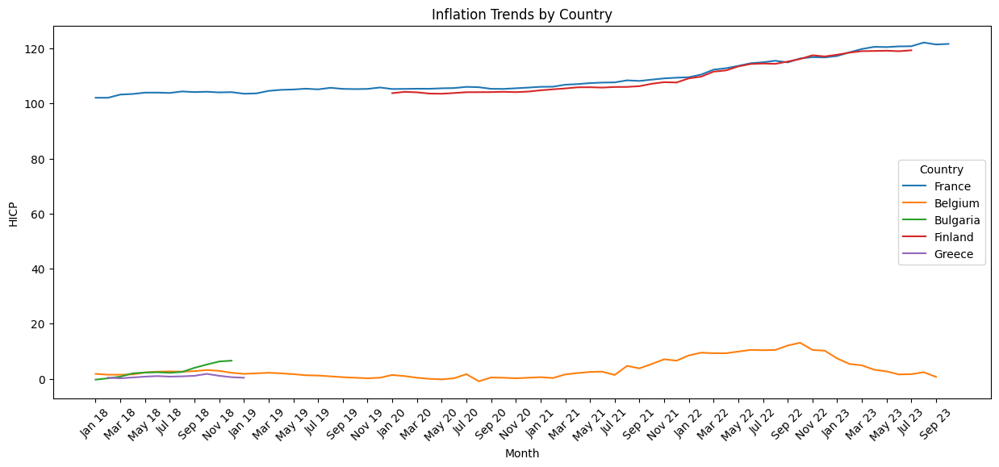

In [398]:
# Plot inflation trends
plt.figure(figsize=(15, 6))
sns.lineplot(data=merged_df_inflation, x='Month', y='HICP', hue='location')
plt.title('Inflation Trends by Country')
plt.xlabel('Month')
plt.ylabel('HICP')
plt.xticks(rotation=45)
plt.xticks(df_HICP_FR['Month'][::2])
plt.legend(title='Country')
plt.show()



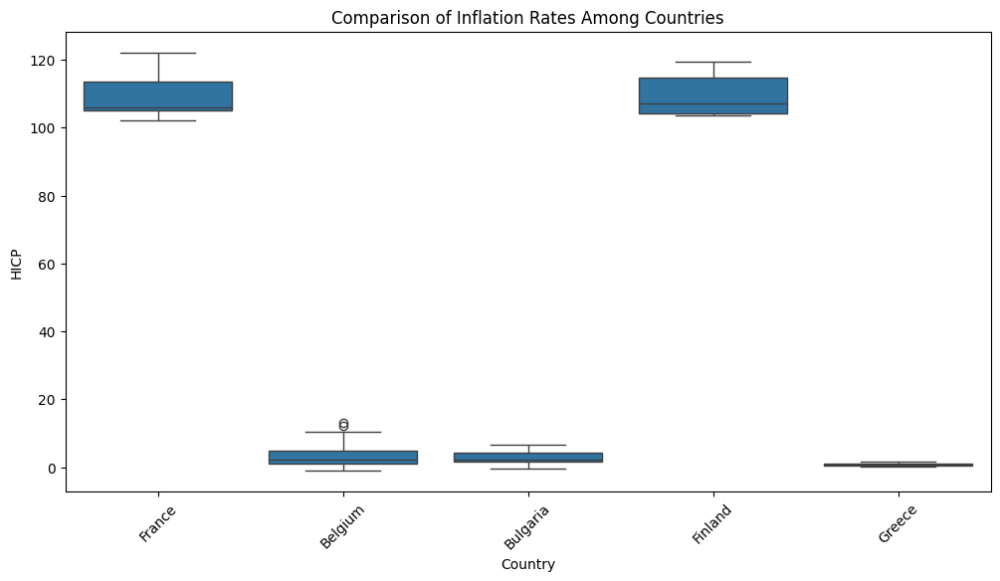

In [399]:
# Compare inflation among countries
plt.figure(figsize=(12, 6))
sns.boxplot(data=merged_df_inflation, x='location', y='HICP')
plt.title('Comparison of Inflation Rates Among Countries')
plt.xlabel('Country')
plt.ylabel('HICP')
plt.xticks(rotation=45)
plt.show()


In [400]:
# Concatenate merged_df_inflation and merged_df_inflation_nrj
df_HICP = pd.concat([merged_df_inflation, merged_df_inflation_nrj], ignore_index=True)

# Print the concatenated dataframe
print(df_HICP)

      Month    HICP location
0    Jan 18  102.06   France
1    Feb 18  102.05   France
2    Mar 18  103.22   France
3    Apr 18  103.43   France
4    May 18  103.92   France
..      ...     ...      ...
505  Jan 23  197.00    Italy
506  Feb 23  188.20    Italy
507  Mar 23  171.40    Italy
508  Apr 23  170.10    Italy
509  May 23  167.80    Italy

[510 rows x 3 columns]


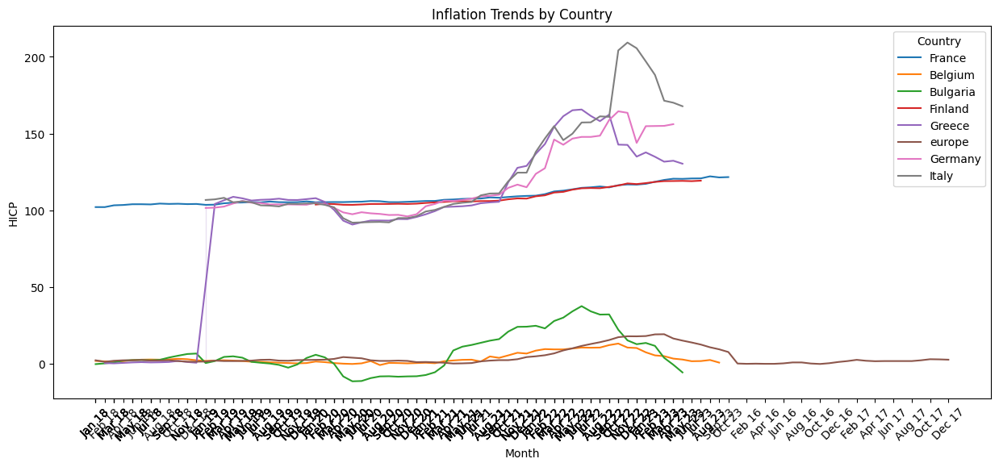

In [401]:
# Plot inflation trends
plt.figure(figsize=(15, 6))
sns.lineplot(data=df_HICP, x='Month', y='HICP', hue='location')
plt.title('Inflation Trends by Country')
plt.xlabel('Month')
plt.ylabel('HICP')
plt.xticks(rotation=45)
plt.xticks(df_HICP['Month'][::2])
plt.legend(title='Country')
plt.show()

In [402]:
# Descriptive statistics
desc_stats = df_HICP.groupby('location')['HICP'].describe()
print(desc_stats)

          count        mean        std     min       25%     50%       75%  \
location                                                                     
Belgium    68.0    3.525000   3.599518   -0.90    1.1500    2.15    5.0250   
Bulgaria   65.0    7.046154  12.722005  -11.50   -0.5000    3.80   13.6000   
Finland    43.0  109.711163   5.799652  103.52  104.2600  107.14  114.8450   
France     70.0  109.031714   5.906146  102.05  105.1325  105.95  113.4175   
Germany    52.0  117.746154  22.246784   96.00  102.5500  106.10  143.0000   
Greece     65.0   95.907846  50.013729    0.20   93.3000  105.42  130.3400   
Italy      53.0  124.750943  34.318170   91.90  102.5000  105.80  149.9000   
europe     94.0    4.340426   5.300106   -0.20    1.5250    2.15    4.2000   

             max  
location          
Belgium    13.10  
Bulgaria   37.50  
Finland   119.28  
France    122.10  
Germany   164.50  
Greece    165.66  
Italy     209.30  
europe     19.19  


In [403]:
from sklearn.preprocessing import StandardScaler

# Separate the data for France, Finland, and Germany
df_standardize_special = df_HICP[df_HICP['location'].isin(['France', 'Finland', 'Germany'])].copy()

# Separate the data for other countries
df_standardize_others = df_HICP[~df_HICP['location'].isin(['France', 'Finland', 'Germany'])].copy()

# Create a StandardScaler object
scaler = StandardScaler()

# Standardize the 'HICP' column for France, Finland, and Germany
df_standardize_special.loc[:, 'HICP'] = scaler.fit_transform(df_standardize_special[['HICP']])

# Standardize the 'HICP' column for the other countries
df_standardize_others.loc[:, 'HICP'] = scaler.fit_transform(df_standardize_others[['HICP']])

# Concatenate the two dataframes back together
df_HICP_std = pd.concat([df_standardize_special, df_standardize_others])

# Sort the dataframe by index to maintain the original order
df_HICP_std = df_HICP_std.sort_index()

# Print the standardized dataframe
print(df_HICP_std)


      Month      HICP location
0    Jan 18 -0.714808   France
1    Feb 18 -0.715530   France
2    Mar 18 -0.631012   France
3    Apr 18 -0.615842   France
4    May 18 -0.580445   France
..      ...       ...      ...
505  Jan 23  2.773234    Italy
506  Feb 23  2.617355    Italy
507  Mar 23  2.319769    Italy
508  Apr 23  2.296742    Italy
509  May 23  2.256001    Italy

[510 rows x 3 columns]


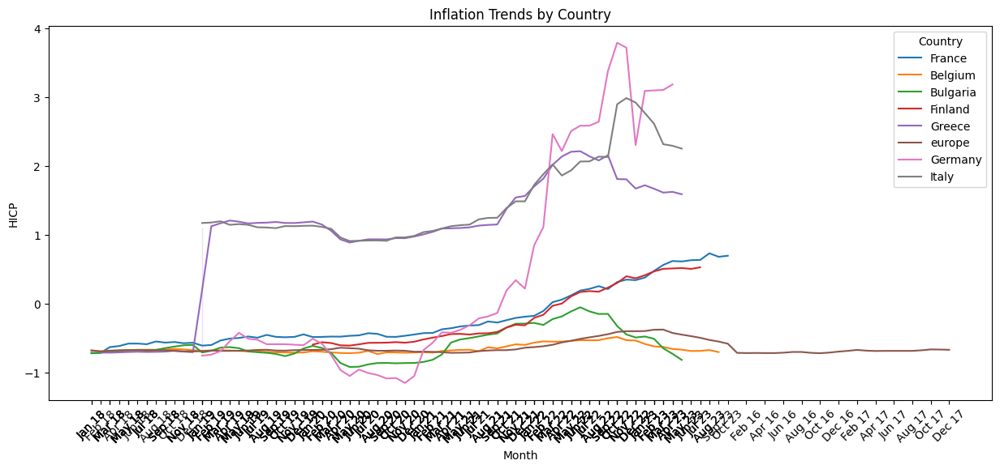

In [404]:
# Plot inflation trends
plt.figure(figsize=(15, 6))
sns.lineplot(data=df_HICP_std, x='Month', y='HICP', hue='location')
plt.title('Inflation Trends by Country')
plt.xlabel('Month')
plt.ylabel('HICP')
plt.xticks(rotation=45)
plt.xticks(df_HICP_std['Month'][::2])
plt.legend(title='Country')
plt.show()

Removing Bulgaria, Greece and Norway is still a good option

Check how to make covid and inflation table compatible

In [405]:
df_HICP_std.rename(columns={'Month': 'date'}, inplace=True)

In [406]:
# Convert 'date' column in df_covid_europe_8countries_4features to datetime
df_covid_europe_8countries_4features['date'] = pd.to_datetime(df_covid_europe_8countries_4features['date'])

# Convert 'Month' column in merged_df_inflation to datetime
df_HICP_std['date'] = pd.to_datetime(df_HICP_std['date'], format='%b %y')


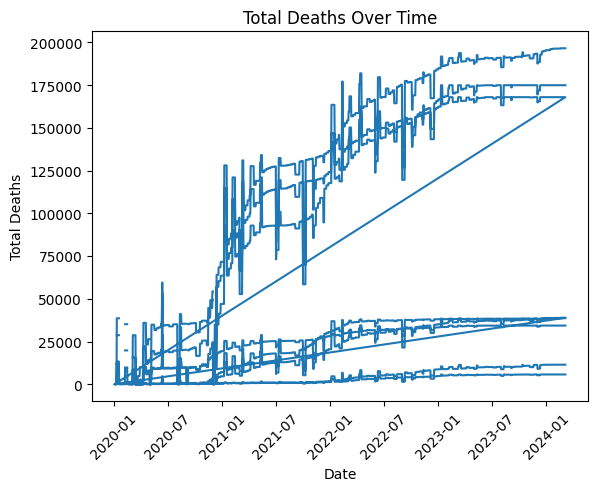

In [407]:
import matplotlib.pyplot as plt

# Create a figure and axis object
fig, ax = plt.subplots()

# Plot the total_deaths column
ax.plot(df_covid_europe_8countries_4features['date'], df_covid_europe_8countries_4features['total_deaths'], linestyle='-')

# Set the title and labels
ax.set_title('Total Deaths Over Time')
ax.set_xlabel('Date')
ax.set_ylabel('Total Deaths')

# Rotate x-axis labels for better readability
plt.xticks(rotation=45)

# Show the plot
plt.show()


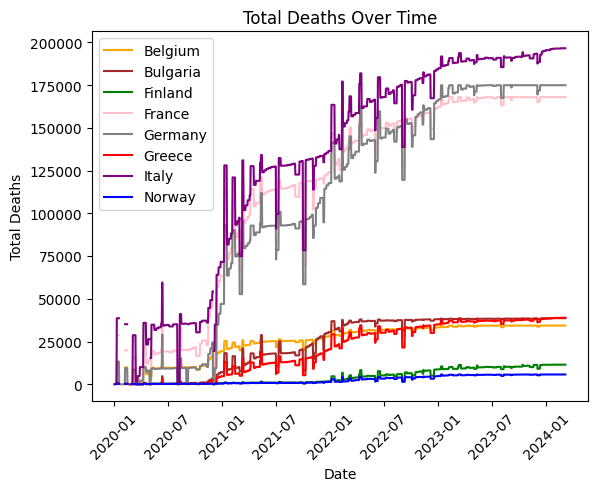

In [408]:
import matplotlib.pyplot as plt

# Create a figure and axis object
fig, ax = plt.subplots()

# Define colors for each location
colors = {'Norway': 'blue', 'Belgium': 'orange', 'Finland': 'green', 'Greece': 'red', 'Italy': 'purple', 'Bulgaria': 'brown', 'France': 'pink', 'Germany': 'gray'}

# Iterate through each location and plot its total deaths
for location, data in df_covid_europe_8countries_4features.groupby('location'):
    ax.plot(data['date'], data['total_deaths'], linestyle='-', label=location, color=colors[location])

# Set the title and labels
ax.set_title('Total Deaths Over Time')
ax.set_xlabel('Date')
ax.set_ylabel('Total Deaths')

# Rotate x-axis labels for better readability
plt.xticks(rotation=45)

# Add a legend
plt.legend()

# Show the plot
plt.show()


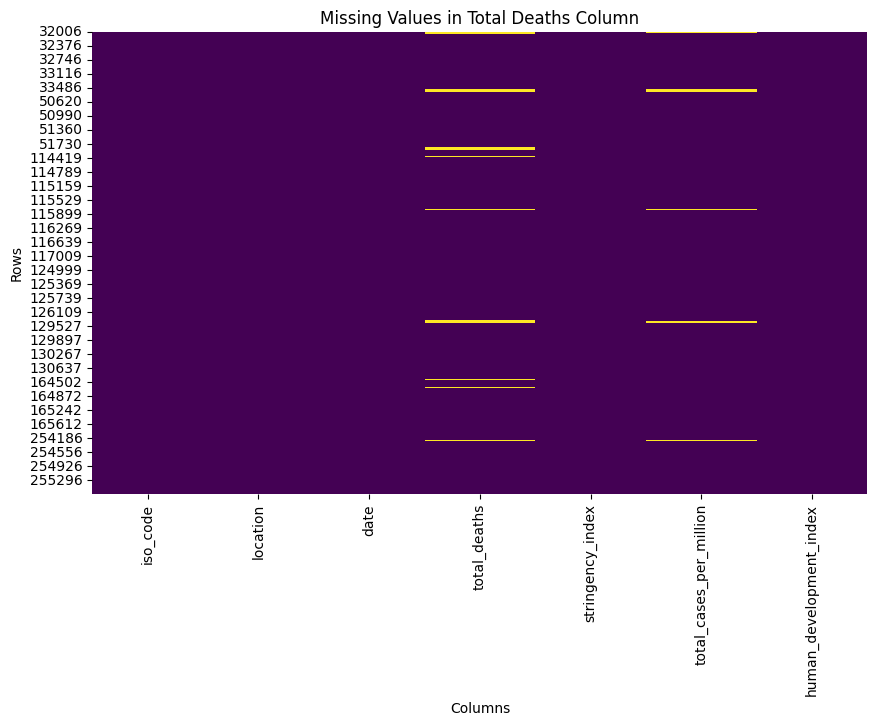

In [409]:
import seaborn as sns
import matplotlib.pyplot as plt

# Create a heatmap to visualize missing values
plt.figure(figsize=(10, 6))
sns.heatmap(df_covid_europe_8countries_4features.isnull(), cmap='viridis', cbar=False)
plt.title('Missing Values in Total Deaths Column')
plt.xlabel('Columns')
plt.ylabel('Rows')
plt.show()


In [410]:
# Get the unique dates with missing values in the total_deaths column
missing_dates = df_covid_europe_8countries_4features[df_covid_europe_8countries_4features['total_deaths'].isnull()]['date'].unique()

# Print the list of unique dates
print(missing_dates)


<DatetimeArray>
['2020-01-03 00:00:00', '2020-01-04 00:00:00', '2020-01-05 00:00:00',
 '2020-01-06 00:00:00', '2020-01-07 00:00:00', '2020-01-08 00:00:00',
 '2020-01-09 00:00:00', '2020-01-10 00:00:00', '2020-01-19 00:00:00',
 '2020-01-20 00:00:00', '2020-01-21 00:00:00', '2020-01-22 00:00:00',
 '2020-01-23 00:00:00', '2020-01-24 00:00:00', '2020-01-25 00:00:00',
 '2020-01-26 00:00:00', '2020-01-27 00:00:00', '2020-01-28 00:00:00',
 '2020-01-29 00:00:00', '2020-01-30 00:00:00', '2020-01-31 00:00:00',
 '2020-02-01 00:00:00', '2020-02-02 00:00:00', '2020-02-03 00:00:00',
 '2020-02-04 00:00:00', '2020-02-05 00:00:00', '2020-02-06 00:00:00',
 '2020-02-07 00:00:00', '2020-02-16 00:00:00', '2020-02-17 00:00:00',
 '2020-02-18 00:00:00', '2020-02-19 00:00:00', '2020-02-20 00:00:00',
 '2020-02-21 00:00:00', '2020-02-22 00:00:00', '2020-02-23 00:00:00',
 '2020-02-24 00:00:00', '2020-02-25 00:00:00', '2020-02-26 00:00:00',
 '2020-02-27 00:00:00', '2020-02-28 00:00:00', '2020-02-29 00:00:00',
 '20

Removing the missing values before may 2020 by 0 and the ones after that date by the value of the day before

In [411]:

# Get the index of the rows where total_deaths is null until the specified date
missing_index = df_covid_europe_8countries_4features[(df_covid_europe_8countries_4features['total_deaths'].isnull()) & 
                                                     (df_covid_europe_8countries_4features['date'] <= '2020-05-03')].index

# Replace the missing values with 0 for the specified index
df_covid_europe_8countries_4features.loc[missing_index, 'total_deaths'] = 0

# Replace the missing values with the value of the day before it for the remaining rows
df_covid_europe_8countries_4features['total_deaths'] = df_covid_europe_8countries_4features['total_deaths'].fillna(method='ffill')

df_covid_europe_8countries_4features


/tmp/ipykernel_3825/1366552587.py:9: FutureWarning:

Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.



,iso_code,location,date,total_deaths,stringency_index,total_cases_per_million,human_development_index
32006,BEL,Belgium,2020-01-03,0.0,0.0,0.086,0.931
32007,BEL,Belgium,2020-01-04,0.0,0.0,0.086,0.931
32008,BEL,Belgium,2020-01-05,0.0,0.0,0.086,0.931
32009,BEL,Belgium,2020-01-06,0.0,0.0,0.086,0.931
32010,BEL,Belgium,2020-01-07,0.0,0.0,0.086,0.931
...,...,...,...,...,...,...,...
255643,NOR,Norway,2024-03-01,5732.0,0.0,277245.339,0.957
255644,NOR,Norway,2024-03-02,5732.0,0.0,277245.339,0.957
255645,NOR,Norway,2024-03-03,5732.0,0.0,277245.339,0.957
255646,NOR,Norway,2024-03-04,5732.0,0.0,277245.339,0.957


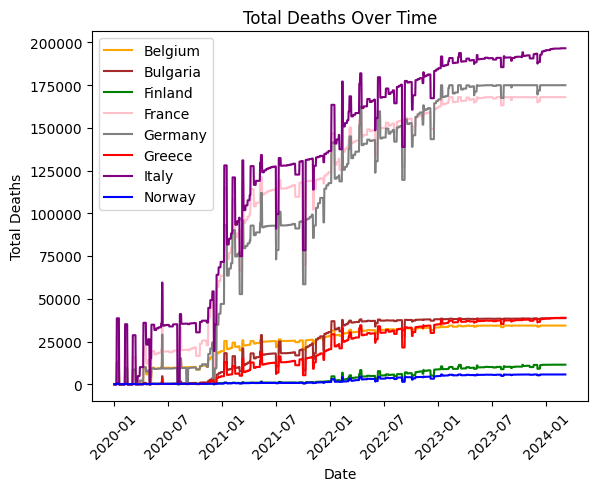

In [412]:
import matplotlib.pyplot as plt

# Create a figure and axis object
fig, ax = plt.subplots()

# Define colors for each location
colors = {'Norway': 'blue', 'Belgium': 'orange', 'Finland': 'green', 'Greece': 'red', 'Italy': 'purple', 'Bulgaria': 'brown', 'France': 'pink', 'Germany': 'gray'}

# Iterate through each location and plot its total deaths
for location, data in df_covid_europe_8countries_4features.groupby('location'):
    ax.plot(data['date'], data['total_deaths'], linestyle='-', label=location, color=colors[location])

# Set the title and labels
ax.set_title('Total Deaths Over Time')
ax.set_xlabel('Date')
ax.set_ylabel('Total Deaths')

# Rotate x-axis labels for better readability
plt.xticks(rotation=45)

# Add a legend
plt.legend()

# Show the plot
plt.show()


In [413]:
# Get the unique dates with missing values in the total_deaths column
missing_dates = df_covid_europe_8countries_4features[df_covid_europe_8countries_4features['total_cases_per_million'].isnull()]['date'].unique()

# Print the list of unique dates
print(missing_dates)


<DatetimeArray>
['2020-01-19 00:00:00', '2020-01-20 00:00:00', '2020-01-21 00:00:00',
 '2020-01-22 00:00:00', '2020-01-23 00:00:00', '2020-01-24 00:00:00',
 '2020-01-25 00:00:00', '2020-01-26 00:00:00', '2020-01-27 00:00:00',
 '2020-01-28 00:00:00', '2020-01-29 00:00:00', '2020-01-30 00:00:00',
 '2020-01-31 00:00:00', '2020-02-01 00:00:00', '2020-02-02 00:00:00',
 '2020-02-03 00:00:00', '2020-02-04 00:00:00', '2020-02-05 00:00:00',
 '2020-02-06 00:00:00', '2020-02-07 00:00:00', '2020-05-01 00:00:00',
 '2020-05-02 00:00:00', '2020-05-03 00:00:00', '2020-12-01 00:00:00',
 '2020-12-02 00:00:00', '2020-12-03 00:00:00', '2020-01-03 00:00:00',
 '2020-01-04 00:00:00', '2020-01-05 00:00:00', '2020-01-06 00:00:00',
 '2020-01-07 00:00:00', '2020-01-08 00:00:00', '2020-01-09 00:00:00',
 '2020-01-10 00:00:00', '2020-02-16 00:00:00', '2020-02-17 00:00:00',
 '2020-02-18 00:00:00', '2020-02-19 00:00:00', '2020-02-20 00:00:00',
 '2020-02-21 00:00:00', '2020-02-22 00:00:00', '2020-02-23 00:00:00',
 '20

In [414]:

# Get the index of the rows where total_deaths is null until the specified date
missing_index = df_covid_europe_8countries_4features[(df_covid_europe_8countries_4features['total_cases_per_million'].isnull()) & 
                                                     (df_covid_europe_8countries_4features['date'] <= '2020-05-03')].index

# Replace the missing values with 0 for the specified index
df_covid_europe_8countries_4features.loc[missing_index, 'total_cases_per_million'] = 0

# Replace the missing values with the value of the day before it for the remaining rows
df_covid_europe_8countries_4features['total_cases_per_million'] = df_covid_europe_8countries_4features['total_cases_per_million'].fillna(method='ffill')

df_covid_europe_8countries_4features


/tmp/ipykernel_3825/186452168.py:9: FutureWarning:

Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.



,iso_code,location,date,total_deaths,stringency_index,total_cases_per_million,human_development_index
32006,BEL,Belgium,2020-01-03,0.0,0.0,0.086,0.931
32007,BEL,Belgium,2020-01-04,0.0,0.0,0.086,0.931
32008,BEL,Belgium,2020-01-05,0.0,0.0,0.086,0.931
32009,BEL,Belgium,2020-01-06,0.0,0.0,0.086,0.931
32010,BEL,Belgium,2020-01-07,0.0,0.0,0.086,0.931
...,...,...,...,...,...,...,...
255643,NOR,Norway,2024-03-01,5732.0,0.0,277245.339,0.957
255644,NOR,Norway,2024-03-02,5732.0,0.0,277245.339,0.957
255645,NOR,Norway,2024-03-03,5732.0,0.0,277245.339,0.957
255646,NOR,Norway,2024-03-04,5732.0,0.0,277245.339,0.957


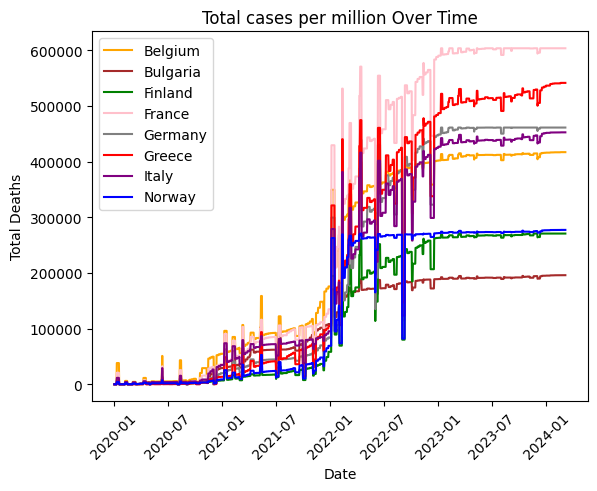

In [415]:
import matplotlib.pyplot as plt

# Create a figure and axis object
fig, ax = plt.subplots()

# Define colors for each location
colors = {'Norway': 'blue', 'Belgium': 'orange', 'Finland': 'green', 'Greece': 'red', 'Italy': 'purple', 'Bulgaria': 'brown', 'France': 'pink', 'Germany': 'gray'}

# Iterate through each location and plot its total deaths
for location, data in df_covid_europe_8countries_4features.groupby('location'):
    ax.plot(data['date'], data['total_cases_per_million'], linestyle='-', label=location, color=colors[location])

# Set the title and labels
ax.set_title('Total cases per million Over Time')
ax.set_xlabel('Date')
ax.set_ylabel('Total Deaths')

# Rotate x-axis labels for better readability
plt.xticks(rotation=45)

# Add a legend
plt.legend()

# Show the plot
plt.show()


* Merge inflation and covid table 

In [416]:
df_covid_europe_8countries_4features.head()

,iso_code,location,date,total_deaths,stringency_index,total_cases_per_million,human_development_index
32006,BEL,Belgium,2020-01-03,0.0,0.0,0.086,0.931
32007,BEL,Belgium,2020-01-04,0.0,0.0,0.086,0.931
32008,BEL,Belgium,2020-01-05,0.0,0.0,0.086,0.931
32009,BEL,Belgium,2020-01-06,0.0,0.0,0.086,0.931
32010,BEL,Belgium,2020-01-07,0.0,0.0,0.086,0.931


In [417]:
# Step 1: Aggregate COVID data by month, taking the median value for numeric features
numeric_columns = ['total_deaths', 'stringency_index', 'total_cases_per_million', 'human_development_index']
df_covid_monthly = df_covid_europe_8countries_4features.groupby([pd.Grouper(key='date', freq='ME'), 'location'])[numeric_columns].median().reset_index()

In [418]:
df_covid_monthly

,date,location,total_deaths,stringency_index,total_cases_per_million,human_development_index
0,2020-01-31,Belgium,0.0,0.0,0.086,0.931
1,2020-01-31,Bulgaria,0.0,0.0,0.000,0.816
2,2020-01-31,Finland,0.0,0.0,1.444,0.938
3,2020-01-31,France,0.0,0.0,0.248,0.901
4,2020-01-31,Germany,11.0,0.0,2.039,0.947
...,...,...,...,...,...,...
403,2024-03-31,France,167985.0,0.0,603427.621,0.901
404,2024-03-31,Germany,174979.0,0.0,461051.095,0.947
405,2024-03-31,Greece,38912.0,0.0,541277.723,0.888
406,2024-03-31,Italy,196592.0,0.0,452455.823,0.892


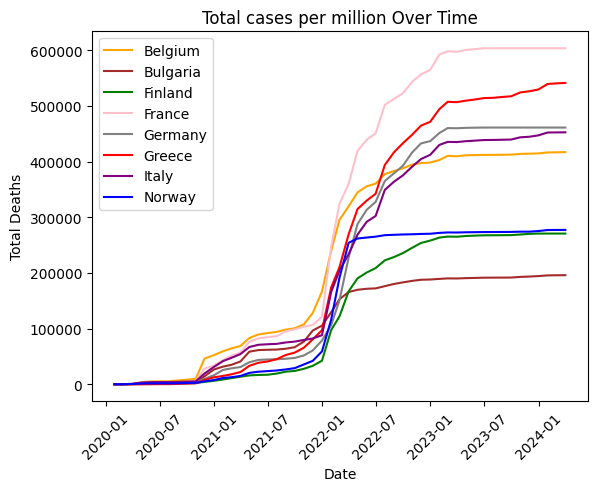

In [419]:
import matplotlib.pyplot as plt

# Create a figure and axis object
fig, ax = plt.subplots()

# Define colors for each location
colors = {'Norway': 'blue', 'Belgium': 'orange', 'Finland': 'green', 'Greece': 'red', 'Italy': 'purple', 'Bulgaria': 'brown', 'France': 'pink', 'Germany': 'gray'}

# Iterate through each location and plot its total deaths
for location, data in df_covid_monthly.groupby('location'):
    ax.plot(data['date'], data['total_cases_per_million'], linestyle='-', label=location, color=colors[location])

# Set the title and labels
ax.set_title('Total cases per million Over Time')
ax.set_xlabel('Date')
ax.set_ylabel('Total Deaths')

# Rotate x-axis labels for better readability
plt.xticks(rotation=45)

# Add a legend
plt.legend()

# Show the plot
plt.show()


In [420]:
'''
# Convert 'date' column to month and year
df_HICP_std['date'] = df_HICP_std['date'].dt.to_period('M')
df_covid_europe_8countries_4features['date'] = df_covid_europe_8countries_4features['date'].dt.to_period('M')

# Merge aggregated COVID data with inflation data based on 'location' and 'date' (month and year)
merged_df = pd.merge(df_HICP_std, df_covid_europe_8countries_4features, on=['location', 'date'], how='inner')

merged_df
'''


"\n# Convert 'date' column to month and year\ndf_HICP_std['date'] = df_HICP_std['date'].dt.to_period('M')\ndf_covid_europe_8countries_4features['date'] = df_covid_europe_8countries_4features['date'].dt.to_period('M')\n\n# Merge aggregated COVID data with inflation data based on 'location' and 'date' (month and year)\nmerged_df = pd.merge(df_HICP_std, df_covid_europe_8countries_4features, on=['location', 'date'], how='inner')\n\nmerged_df\n"

In [421]:
# Step 2: Convert 'date' column to month and year
df_HICP_std['date'] = df_HICP_std['date'].dt.to_period('M')
df_covid_monthly['date'] = df_covid_monthly['date'].dt.to_period('M')

# Step 3: Merge aggregated COVID data with inflation data based on 'location' and 'date' (month and year)
df_covid_HICP = pd.merge(df_HICP_std, df_covid_monthly, on=['location', 'date'], how='inner')

df_covid_HICP

,date,HICP,location,total_deaths,stringency_index,total_cases_per_million,human_development_index
0,2020-01,-0.485091,France,0.0,0.00,0.248,0.901
1,2020-02,-0.482923,France,0.0,5.56,0.248,0.901
2,2020-03,-0.477867,France,713.0,56.94,0.248,0.901
3,2020-04,-0.479311,France,12062.0,87.96,0.248,0.901
4,2020-05,-0.467031,France,17992.0,76.85,77.878,0.901
...,...,...,...,...,...,...,...
292,2023-01,2.773234,Italy,186158.0,0.00,429911.498,0.892
293,2023-02,2.617355,Italy,189155.0,0.00,435336.171,0.892
294,2023-03,2.319769,Italy,188974.0,0.00,434980.482,0.892
295,2023-04,2.296742,Italy,189627.0,0.00,436544.082,0.892


In [422]:
# Select the countries of interest
selected_countries = ['Belgium', 'Finland', 'Italy', 'France', 'Germany']

df_covid_HICP = df_covid_HICP[df_covid_HICP['location'].isin(selected_countries)]

df_covid_HICP

,date,HICP,location,total_deaths,stringency_index,total_cases_per_million,human_development_index
0,2020-01,-0.485091,France,0.0,0.00,0.248,0.901
1,2020-02,-0.482923,France,0.0,5.56,0.248,0.901
2,2020-03,-0.477867,France,713.0,56.94,0.248,0.901
3,2020-04,-0.479311,France,12062.0,87.96,0.248,0.901
4,2020-05,-0.467031,France,17992.0,76.85,77.878,0.901
...,...,...,...,...,...,...,...
292,2023-01,2.773234,Italy,186158.0,0.00,429911.498,0.892
293,2023-02,2.617355,Italy,189155.0,0.00,435336.171,0.892
294,2023-03,2.319769,Italy,188974.0,0.00,434980.482,0.892
295,2023-04,2.296742,Italy,189627.0,0.00,436544.082,0.892


**Look at other economic tables**

In [423]:
# Read the dataframes
df_education = pd.read_csv('Data/Education-GDP.csv', delimiter=',')
df_GDP = pd.read_csv('Data/GDP.csv', delimiter=',')
df_gini = pd.read_csv('Data/gini.csv', delimiter=',')
df_poverty = pd.read_csv('Data/poverty-explorer.csv', delimiter=',')
df_trade = pd.read_csv('Data/trade.csv', delimiter=',')


selected_countries = ['Belgium', 'Finland', 'Italy', 'France', 'Germany']

# Define a function to perform the required transformations
def preprocess_dataframe(df):
    # Replace "Country" or "Entity" with "location"
    df.rename(columns={'Country': 'location', 'Entity': 'location'}, inplace=True)
    
    # Convert "Year" to datetime and rename it to "date"
    df['date'] = pd.to_datetime(df['Year'], format='%Y')
    df.drop(columns=['Year'], inplace=True)

    # Drop the "Code" column
    if 'Code' in df.columns:
        df.drop(columns=['Code'], inplace=True)

    # Select only rows concerning selected countries and after 2017
    df = df[(df['location'].isin(selected_countries)) & (df['date'].dt.year >= 2017)]
    
    return df

# Apply the preprocessing function to each DataFrame
df_education = preprocess_dataframe(df_education)
df_GDP = preprocess_dataframe(df_GDP)
df_gini = preprocess_dataframe(df_gini)
df_poverty = preprocess_dataframe(df_poverty)
df_trade = preprocess_dataframe(df_trade)



In [424]:
df_education.rename(columns={df_education.columns[1]: 'education'}, inplace=True)
df_education

,location,education,date
478,Belgium,6.425340,2017-01-01
479,Belgium,6.381070,2018-01-01
480,Belgium,6.333970,2019-01-01
481,Belgium,6.812330,2020-01-01
482,Belgium,6.234233,2021-01-01
1683,Finland,6.363110,2017-01-01
1684,Finland,6.275580,2018-01-01
1685,Finland,6.416950,2019-01-01
1686,Finland,6.634940,2020-01-01
1687,Finland,5.693809,2021-01-01


In [425]:
df_GDP.rename(columns={df_GDP.columns[1]: 'GDP'}, inplace=True)
df_GDP.drop(columns=[df_GDP.columns[2]], inplace=True)
df_GDP = df_GDP[df_GDP['date'].dt.year <= 2022]
df_GDP

,location,GDP,date
771,Belgium,1.620,2017-01-01
772,Belgium,1.793,2018-01-01
773,Belgium,2.262,2019-01-01
774,Belgium,-5.363,2020-01-01
775,Belgium,6.286,2021-01-01
776,Belgium,3.248,2022-01-01
2748,Finland,3.192,2017-01-01
2749,Finland,1.140,2018-01-01
2750,Finland,1.224,2019-01-01
2751,Finland,-2.355,2020-01-01


In [426]:
df_gini.rename(columns={df_gini.columns[1]: 'gini'}, inplace=True)
df_gini

,location,gini,date
172,Belgium,0.273880,2017-01-01
173,Belgium,0.272144,2018-01-01
174,Belgium,0.272198,2019-01-01
175,Belgium,0.259583,2020-01-01
739,Finland,0.273831,2017-01-01
740,Finland,0.273298,2018-01-01
741,Finland,0.277373,2019-01-01
742,Finland,0.270912,2020-01-01
769,France,0.316321,2017-01-01
770,France,0.323807,2018-01-01


In [427]:
# Selecting relevant columns
relevant_columns = ['location', 'date', 'Median income or consumption per day', 
                    'Threshold income or consumption per day marking the poorest decile', 
                    'Threshold income or consumption per day marking the richest decile']

# Create a new DataFrame with the selected columns
df_poverty = df_poverty[relevant_columns].copy()

# Renaming columns
df_poverty.rename(columns={'Median income or consumption per day': 'median_income',
                                     'Threshold income or consumption per day marking the poorest decile': 'poorest_decile_threshold',
                                     'Threshold income or consumption per day marking the richest decile': 'richest_decile_threshold'},
                           inplace=True)
df_poverty

,location,date,median_income,poorest_decile_threshold,richest_decile_threshold
172,Belgium,2017-01-01,50.106460,25.195316,89.483215
173,Belgium,2018-01-01,51.246574,26.038218,90.039635
174,Belgium,2019-01-01,52.628468,27.698778,93.140700
175,Belgium,2020-01-01,53.040030,28.693867,91.954960
827,Finland,2017-01-01,49.616215,28.033659,90.452280
828,Finland,2018-01-01,50.388140,28.374876,91.765030
829,Finland,2019-01-01,51.262200,28.351320,92.979256
830,Finland,2020-01-01,51.208990,29.307734,92.387900
857,France,2017-01-01,49.441666,24.629000,94.996870
858,France,2018-01-01,49.589756,24.751944,96.168710


In [428]:
df_trade.rename(columns={df_trade.columns[1]: 'trade'}, inplace=True)
df_trade

,location,trade,date
733,Belgium,165.325840,2017-01-01
734,Belgium,166.494780,2018-01-01
735,Belgium,164.176910,2019-01-01
736,Belgium,157.180730,2020-01-01
737,Belgium,172.674450,2021-01-01
3016,Finland,75.053140,2017-01-01
3017,Finland,78.192170,2018-01-01
3018,Finland,79.605430,2019-01-01
3019,Finland,71.634120,2020-01-01
3020,Finland,78.604590,2021-01-01


In [429]:
# Merge df_education with df_GDP
merged_df = df_education.merge(df_GDP, on=['location', 'date'], how='outer')

# Merge the result with df_gini
merged_df = merged_df.merge(df_gini, on=['location', 'date'], how='outer')

# Merge the result with df_poverty
merged_df = merged_df.merge(df_poverty, on=['location', 'date'], how='outer')

# Merge the result with df_trade
df_economics = merged_df.merge(df_trade, on=['location', 'date'], how='outer')

df_economics


,location,education,date,GDP,gini,median_income,poorest_decile_threshold,richest_decile_threshold,trade
0,Belgium,6.425340,2017-01-01,1.620,0.273880,50.106460,25.195316,89.483215,165.325840
1,Belgium,6.381070,2018-01-01,1.793,0.272144,51.246574,26.038218,90.039635,166.494780
2,Belgium,6.333970,2019-01-01,2.262,0.272198,52.628468,27.698778,93.140700,164.176910
3,Belgium,6.812330,2020-01-01,-5.363,0.259583,53.040030,28.693867,91.954960,157.180730
4,Belgium,6.234233,2021-01-01,6.286,NaN,NaN,NaN,NaN,172.674450
5,Belgium,NaN,2022-01-01,3.248,NaN,NaN,NaN,NaN,NaN
6,Finland,6.363110,2017-01-01,3.192,0.273831,49.616215,28.033659,90.452280,75.053140
7,Finland,6.275580,2018-01-01,1.140,0.273298,50.388140,28.374876,91.765030,78.192170
8,Finland,6.416950,2019-01-01,1.224,0.277373,51.262200,28.351320,92.979256,79.605430
9,Finland,6.634940,2020-01-01,-2.355,0.270912,51.208990,29.307734,92.387900,71.634120


In [430]:
# Extract month and year from 'date' column
df_economics['date'] = df_economics['date'].dt.to_period('M')



In [431]:


merged_df = pd.merge(df_economics, df_covid_HICP, on=['location', 'date'], how='left', indicator=True)


# Drop the 'year_month' column as it's no longer needed
#merged_df.drop('year_month', axis=1, inplace=True)

merged_df

,location,education,date,GDP,gini,median_income,poorest_decile_threshold,richest_decile_threshold,trade,HICP,total_deaths,stringency_index,total_cases_per_million,human_development_index,_merge
0,Belgium,6.425340,2017-01,1.620,0.273880,50.106460,25.195316,89.483215,165.325840,NaN,NaN,NaN,NaN,NaN,left_only
1,Belgium,6.381070,2018-01,1.793,0.272144,51.246574,26.038218,90.039635,166.494780,NaN,NaN,NaN,NaN,NaN,left_only
2,Belgium,6.333970,2019-01,2.262,0.272198,52.628468,27.698778,93.140700,164.176910,NaN,NaN,NaN,NaN,NaN,left_only
3,Belgium,6.812330,2020-01,-5.363,0.259583,53.040030,28.693867,91.954960,157.180730,-0.691518,0.0,0.00,0.086,0.931,both
4,Belgium,6.234233,2021-01,6.286,NaN,NaN,NaN,NaN,172.674450,-0.705689,20963.0,60.19,59227.485,0.931,both
5,Belgium,NaN,2022-01,3.248,NaN,NaN,NaN,NaN,NaN,-0.565753,28814.0,33.84,239519.170,0.931,both
6,Finland,6.363110,2017-01,3.192,0.273831,49.616215,28.033659,90.452280,75.053140,NaN,NaN,NaN,NaN,NaN,left_only
7,Finland,6.275580,2018-01,1.140,0.273298,50.388140,28.374876,91.765030,78.192170,NaN,NaN,NaN,NaN,NaN,left_only
8,Finland,6.416950,2019-01,1.224,0.277373,51.262200,28.351320,92.979256,79.605430,NaN,NaN,NaN,NaN,NaN,left_only
9,Finland,6.634940,2020-01,-2.355,0.270912,51.208990,29.307734,92.387900,71.634120,-0.594893,0.0,0.00,1.444,0.938,both


In [432]:
'''
# Merge df_economics with df_covid_HICP on location and date
merged_df = pd.merge(df_economics, df_covid_HICP, on=['location', 'date'], how='left', suffixes=('', '_covid'))

# Filter out rows from df_covid_HICP that are not present in the merged DataFrame
remaining_rows = df_covid_HICP.loc[~df_covid_HICP.set_index(['location', 'date']).index.isin(merged_df.set_index(['location', 'date']).index)]

# Concatenate the remaining rows to the merged DataFrame
merged_df = pd.concat([merged_df, remaining_rows], ignore_index=True)

# Sort the merged DataFrame by location and date
merged_df = merged_df.sort_values(by=['location', 'date'])

# Display the merged DataFrame
print(merged_df)

'''

"\n# Merge df_economics with df_covid_HICP on location and date\nmerged_df = pd.merge(df_economics, df_covid_HICP, on=['location', 'date'], how='left', suffixes=('', '_covid'))\n\n# Filter out rows from df_covid_HICP that are not present in the merged DataFrame\nremaining_rows = df_covid_HICP.loc[~df_covid_HICP.set_index(['location', 'date']).index.isin(merged_df.set_index(['location', 'date']).index)]\n\n# Concatenate the remaining rows to the merged DataFrame\nmerged_df = pd.concat([merged_df, remaining_rows], ignore_index=True)\n\n# Sort the merged DataFrame by location and date\nmerged_df = merged_df.sort_values(by=['location', 'date'])\n\n# Display the merged DataFrame\nprint(merged_df)\n\n"